# imports

In [31]:
import pandas as pd
import numpy as np
from IPython.display import display
import seaborn as sns
from scipy import stats
from sklearn.feature_selection import SelectKBest, mutual_info_classif
import sklearn
import matplotlib.pyplot as plt
import librosa
import IPython.display as ipd
import librosa.display
%matplotlib inline

# load data

In [33]:
malicious_data1 = r"C:\Users\edenm\Documents\GitHub\VoIP-Research\Data\proccesed and tagged external datasets\RTP Flood records\malicious recordings\RTP_A_Host_Attacker\rtp.0.0_.wav"

In [35]:
malicious_data2 = r"C:\Users\edenm\Documents\GitHub\VoIP-Research\Data\proccesed and tagged external datasets\RTP Flood records\malicious recordings\RTP_B_Host_Attacker\rtp.0.1_.wav"

In [25]:
benign_data = r"C:\Users\edenm\Documents\GitHub\VoIP-Research\Data\proccesed and tagged external datasets\RTP Flood records\benign recording\RTP_A_Host_Asterisk_IP-PBX\rtp.0.0_.wav"

In [36]:
malicious_data1, malicious_sr1 = librosa.load(malicious_data1)

In [37]:
malicious_data2, malicious_sr2 = librosa.load(malicious_data2)

In [27]:
benign_data, benign_sr = librosa.load(benign_data)

In [41]:
ipd.Audio(data = malicious_data1, rate = malicious_sr1)

In [39]:
ipd.Audio(data = malicious_data2, rate = malicious_sr2)

In [28]:
ipd.Audio(data = benign_data, rate = benign_sr)

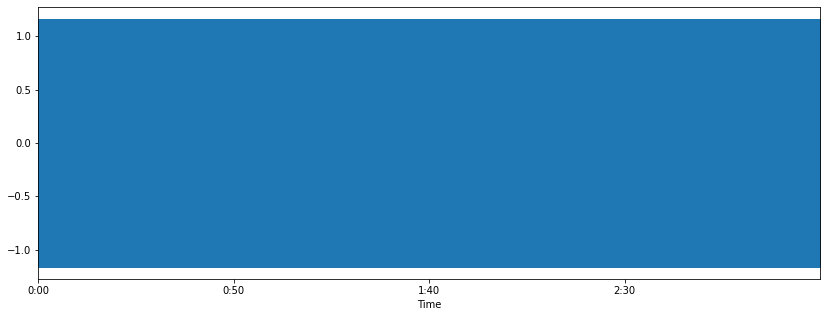

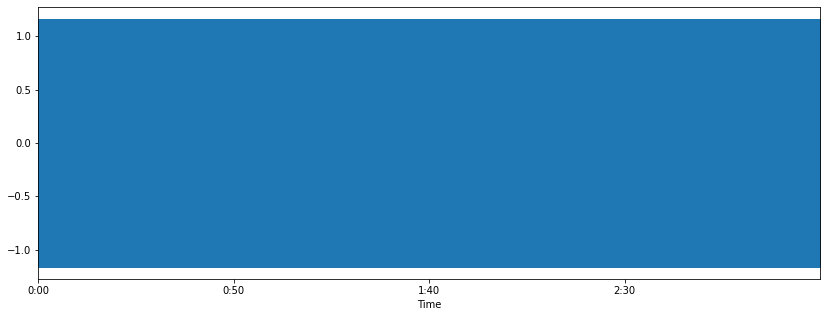

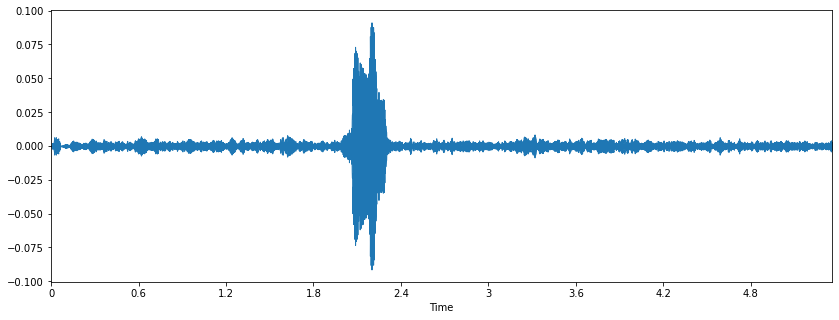

In [43]:
%matplotlib inline
plt.figure(figsize=(14, 5))
librosa.display.waveplot(malicious_data1, malicious_sr1)
plt.show()
%matplotlib inline
plt.figure(figsize=(14, 5))
librosa.display.waveplot(malicious_data2, malicious_sr2)
plt.show()
%matplotlib inline
plt.figure(figsize=(14, 5))
librosa.display.waveplot(benign_data, benign_sr)
plt.show()

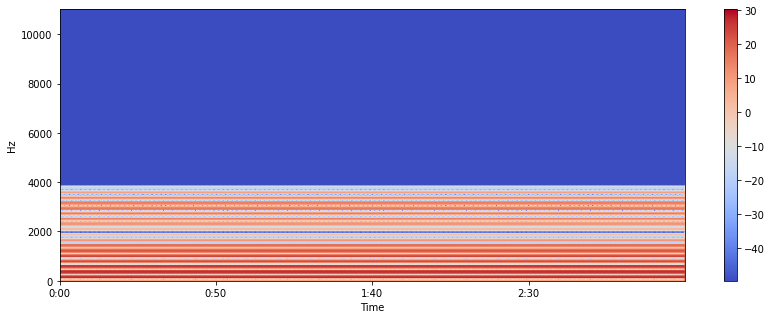

C:\Users\edenm\Anaconda3\lib\site-packages\librosa\display.py:862: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\Users\edenm\Anaconda3\lib\site-packages\librosa\display.py:862: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\Users\edenm\Anaconda3\lib\site-packages\librosa\display.py:862: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


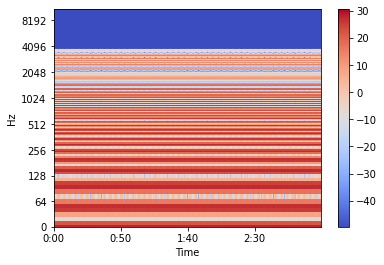

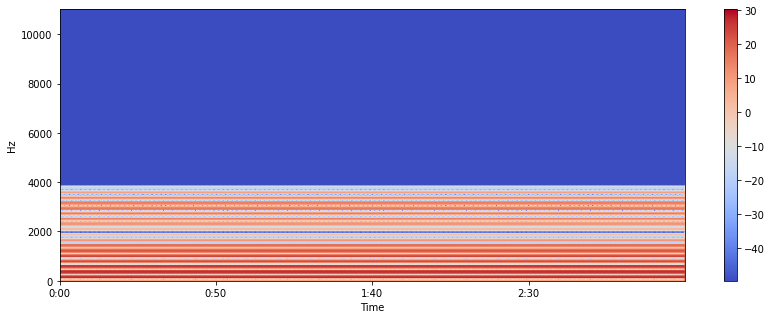

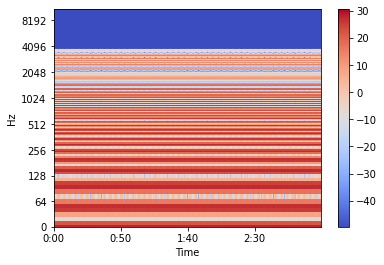

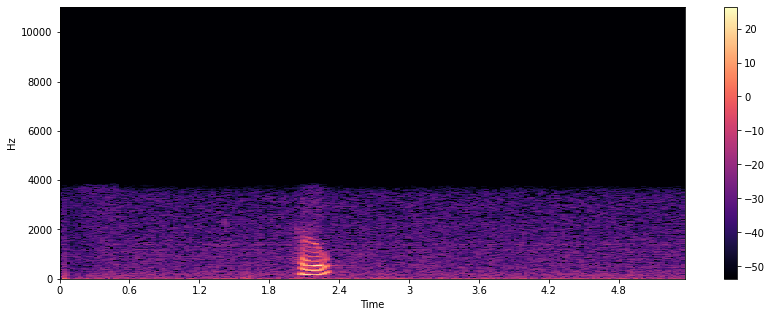

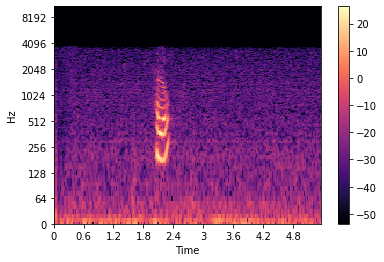

In [45]:
X = librosa.stft(malicious_data1)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()
plt.show()

X = librosa.stft(malicious_data2)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()
plt.show()

X = librosa.stft(benign_data)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()
plt.show()

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()
plt.show()

In [57]:
def normalize(data, axis=0):
    return sklearn.preprocessing.minmax_scale(data, axis=axis)

In [58]:
spectral_centroids1 = librosa.feature.spectral_centroid(malicious_data1, malicious_sr1)[0]
spectral_centroids1.shape

(8609,)

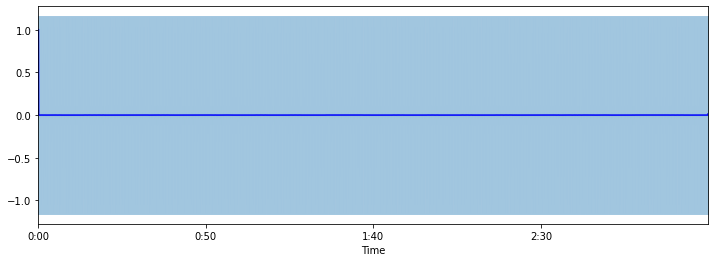

In [60]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids1))
t = librosa.frames_to_time(frames)
librosa.display.waveplot(malicious_data1, malicious_sr1, alpha=0.4)
plt.plot(t, normalize(spectral_centroids1), color='b')
plt.show()

In [61]:
spectral_centroids2 = librosa.feature.spectral_centroid(malicious_data2, malicious_sr2)[0]
spectral_centroids2.shape

(8609,)

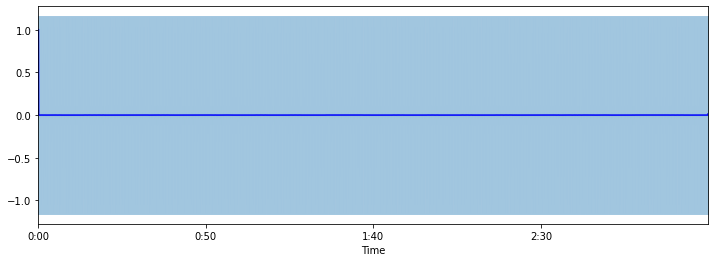

In [62]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids2))
t = librosa.frames_to_time(frames)
librosa.display.waveplot(malicious_data2, malicious_sr2, alpha=0.4)
plt.plot(t, normalize(spectral_centroids2), color='b')
plt.show()

In [48]:
spectral_centroids = librosa.feature.spectral_centroid(benign_data, benign_sr)[0]
spectral_centroids.shape

(231,)